## Import Packages

In [1]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
from moviepy.editor import VideoFileClip
from PIL import Image, ImageDraw, ImageFont
%matplotlib inline

## Utility functions

In [2]:
def showResultImages(idx, img1, img2, title1 = 'Original Image', title2 = "Result", cmap1="BrBG", cmap2="BrBG") :
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(img1, cmap=cmap1)
    ax1.set_title(title1 + " " + str(idx), fontsize=40)

    ax2.imshow(img2, cmap=cmap2)
    ax2.set_title(title2, fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
def frange(x, y, jump) :
    while x <= y : 
        yield x
        x += jump

## Calculate camera calibrate parameter 

In [3]:
print("Calculating...")
nx = 9
ny = 6

objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)


imgpoints = []
objpoints = []

for i in range(1, 20) : 
    testImg = mpimg.imread('camera_cal/calibration' + str(i) + '.jpg')
    gray = cv2.cvtColor(testImg, cv2.COLOR_RGB2GRAY)
    
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

    if ret == True:
        # Draw and display the corners
        objpoints.append(objp)
        imgpoints.append(corners)

print("Camera Calibrate Parameters have been calculated")
        

Calculating...
Camera Calibrate Parameters have been calculated


# Distort calibration images to verify

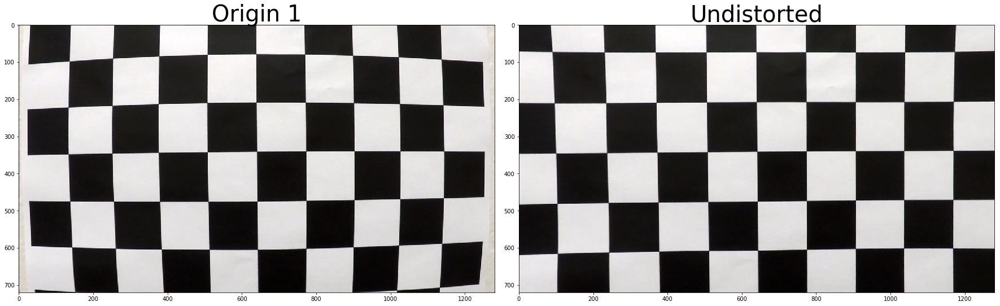

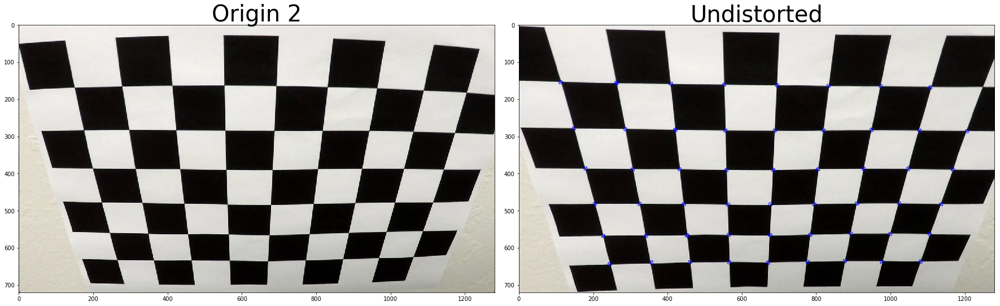

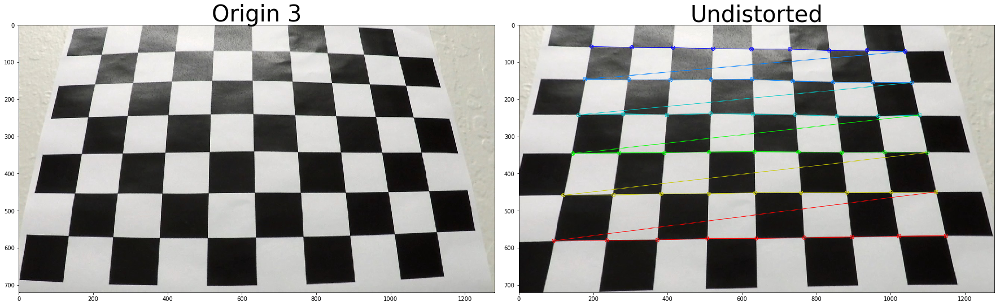

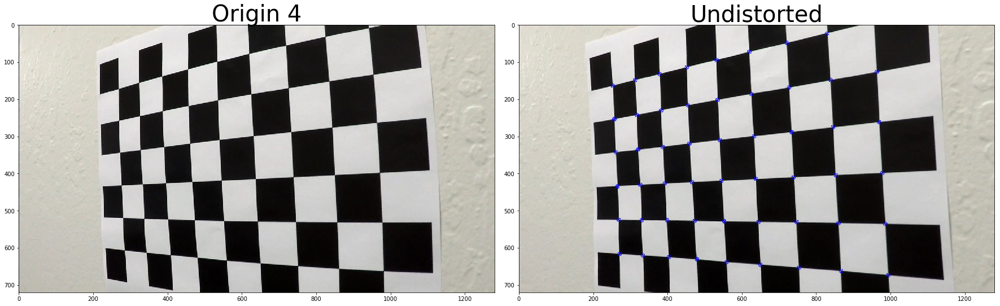

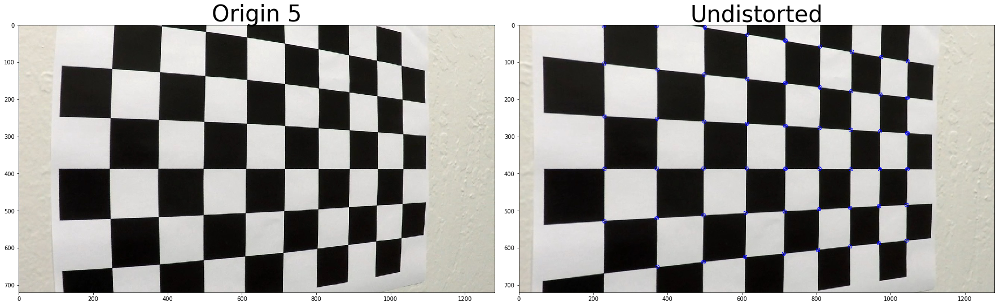

...

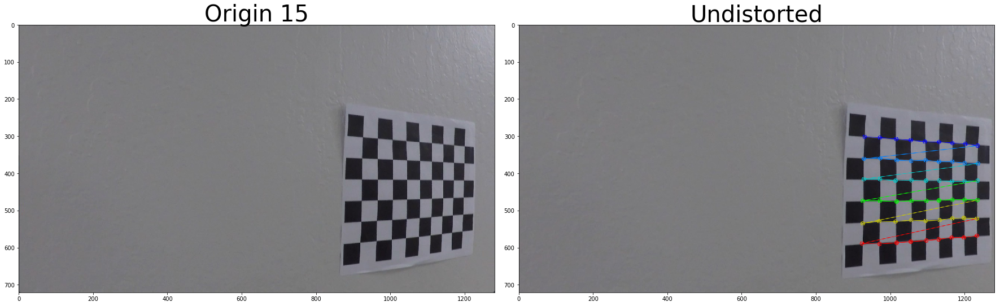

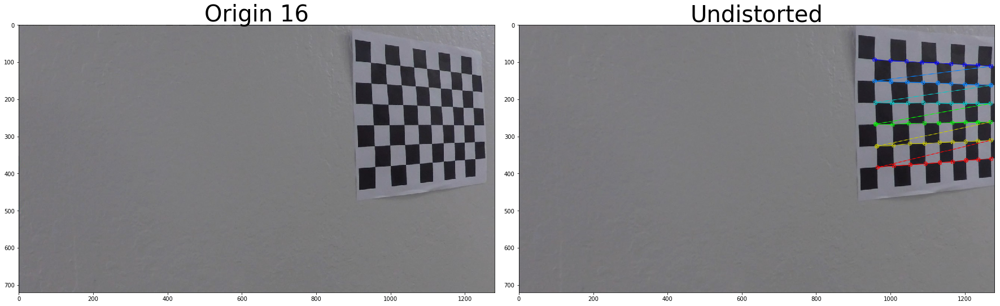

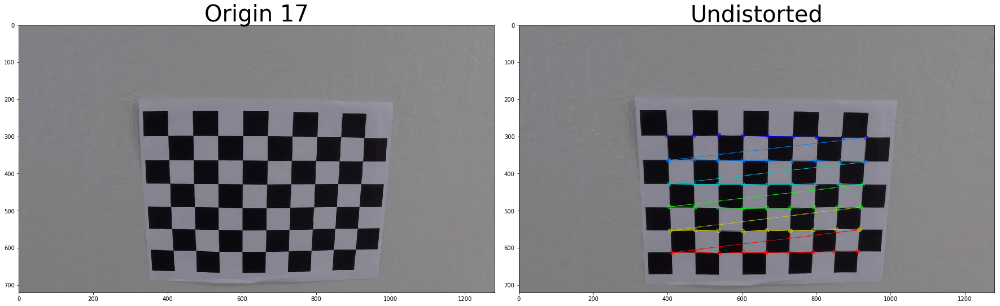

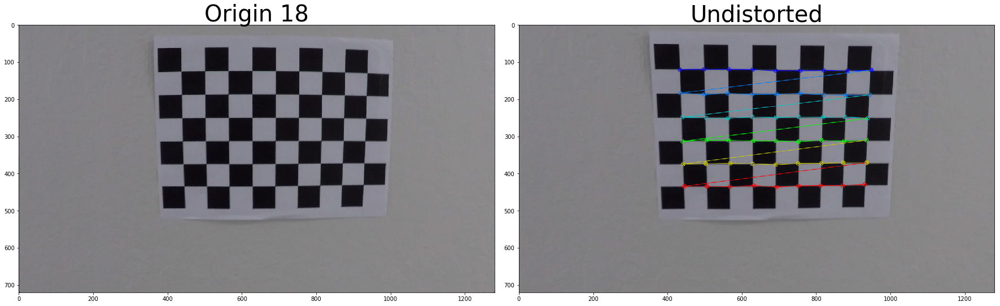

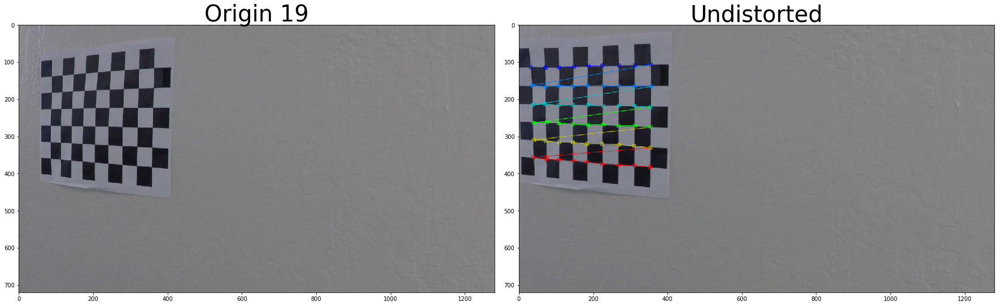

In [4]:
def cal_undistort(img, objpoints, imgpoints):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Use cv2.calibrateCamera() and cv2.undistort()
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    return (mtx, dist, dst)


   
plt.figure()
for i in range(1, 20) : 
    testImg = mpimg.imread('camera_cal/calibration' + str(i) + '.jpg')
    mtx, dist, undistorted = cal_undistort(testImg, objpoints, imgpoints)
    ret, corners = cv2.findChessboardCorners(undistorted, (nx, ny), None)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(testImg)
    ax1.set_title("Origin " + str(i), fontsize=40)

    cv2.drawChessboardCorners(undistorted, (nx, ny), corners, ret)
    ax2.imshow(undistorted, cmap='gray')
    ax2.set_title("Undistorted", fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    


# Undistorb test images

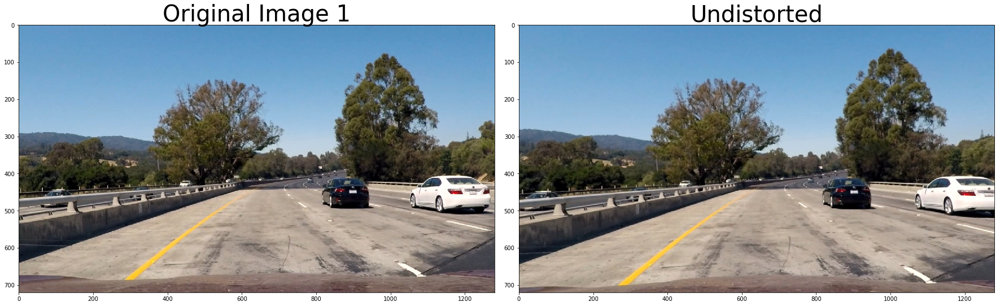

In [6]:
plt.figure()

rawImages = []
processedImages = []

displayed = False
for i in range(1, 9) : 
    testImg = mpimg.imread('test_images/test' + str(i) + '.jpg')
    rawImages.append(testImg)
    mtx, dist, undistorted = cal_undistort(testImg, objpoints, imgpoints)
    if not displayed :
        showResultImages(i, testImg, undistorted, title2="Undistorted")
        displayed = True
    processedImages.append(testImg)
    
w, h = rawImages[0].shape[1], rawImages[0].shape[0]    

    

## Show red lines

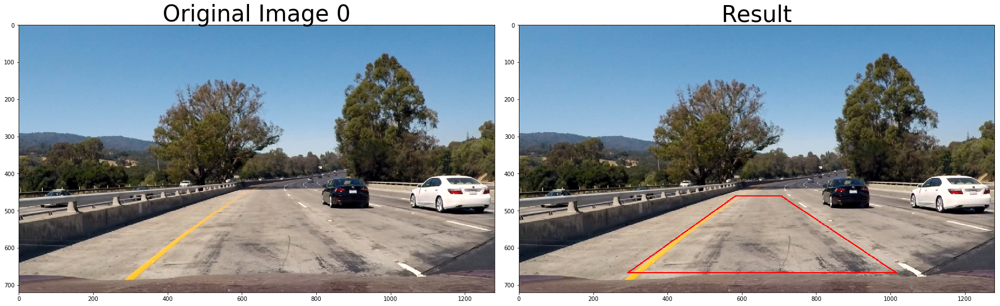

In [7]:
fourPoints = [(582, 460), (705, 460), (1015, 667), (292, 667)]

def drawBorder(img, fourPoints = [(582, 460), (705, 460), (1015, 667), (292, 667)]) :
    color = (255, 0, 0)
    cv2.line(img,fourPoints[0], fourPoints[1],color,2)
    cv2.line(img,fourPoints[1], fourPoints[2],color,2)
    cv2.line(img,fourPoints[2], fourPoints[3],color,2)
    cv2.line(img,fourPoints[0], fourPoints[3],color,2)

redLineImages = []

i = 0
newImg = rawImages[i].copy()
drawBorder(newImg, fourPoints)
showResultImages(i, rawImages[i], newImg)


## Perspective Transform

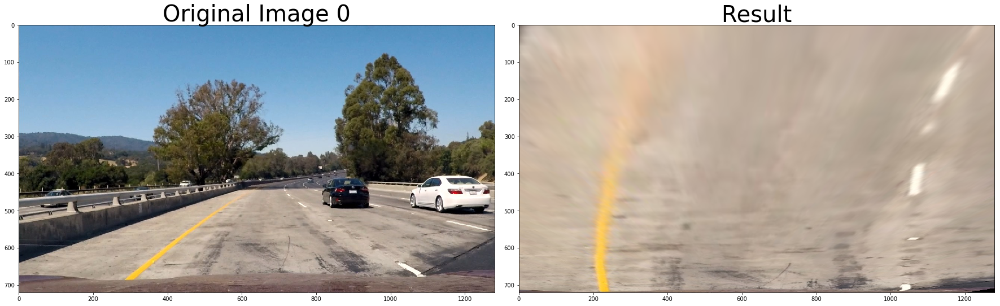

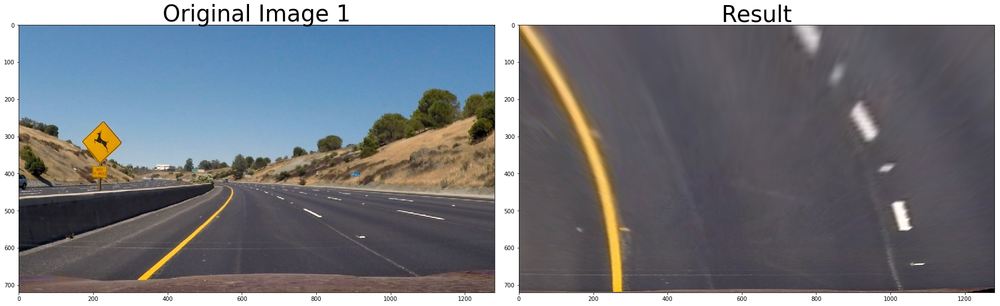

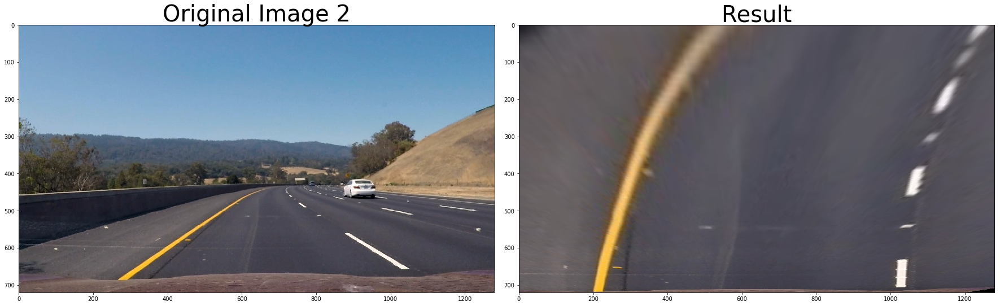

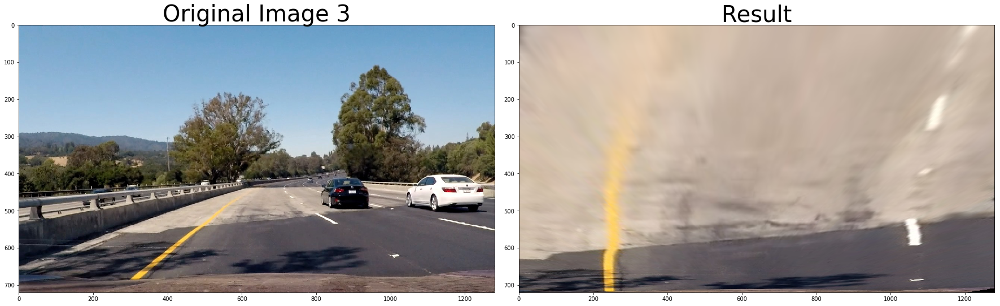

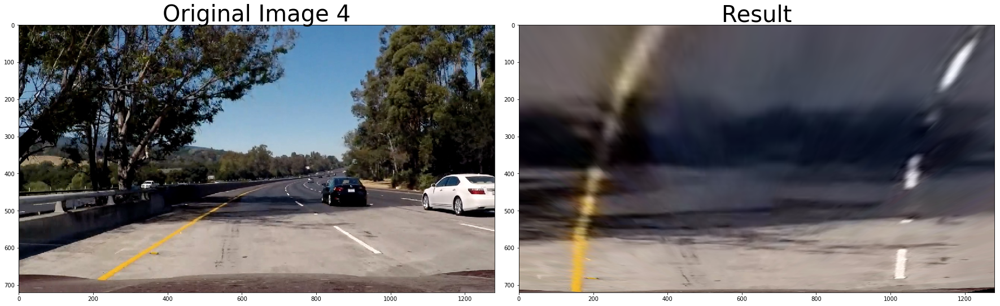

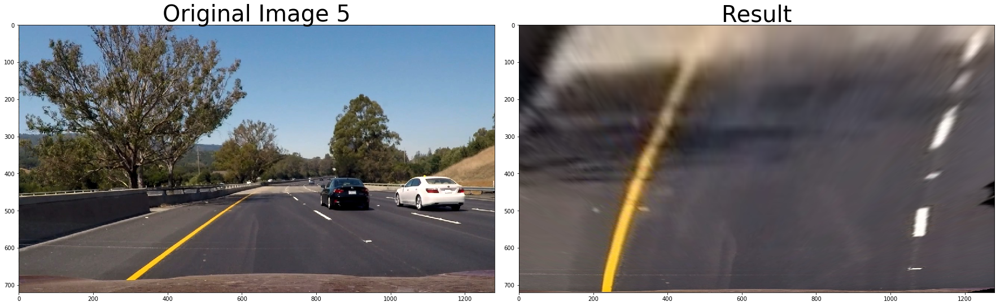

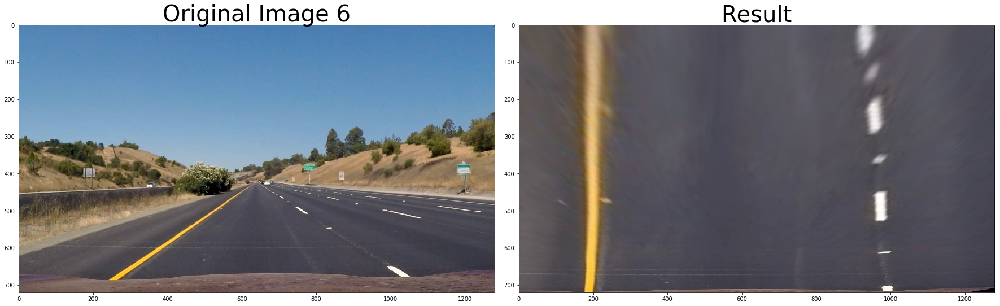

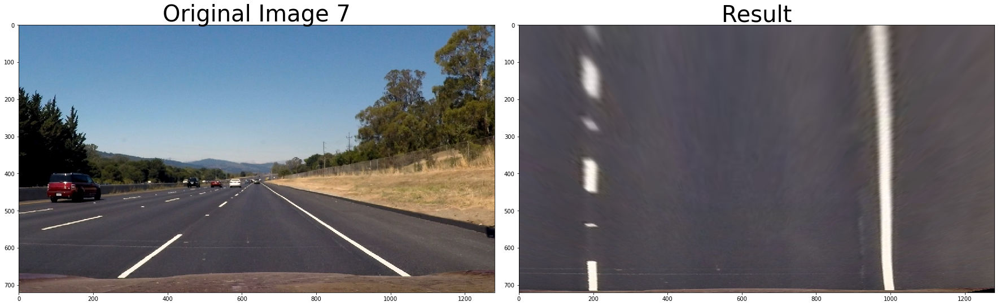

In [8]:
offsetLeft = 200
offsetRight = 300
offsetTop = 200
offsetBottom = 10
    
w, h = processedImages[0].shape[1], processedImages[0].shape[0]

fourPoints = [(582, 460), (705, 460), (1015, 667), (292, 667)]
src = np.float32(fourPoints)
dst = np.float32([[offsetLeft, offsetTop], [w - offsetRight, offsetTop],[w - offsetRight, h - offsetBottom], [offsetLeft, h - offsetBottom]])


M = cv2.getPerspectiveTransform(src, dst)
MinV = cv2.getPerspectiveTransform(dst, src)

i = 0
warppedImages = []
displayed = False
for img in processedImages :
    warpped = cv2.warpPerspective(img, M, (w, h))
    if not displayed :
        showResultImages(i, img, warpped, cmap1="gray", cmap2="gray")
    warppedImages.append(warpped)
    i = i + 1

## Apply gradient

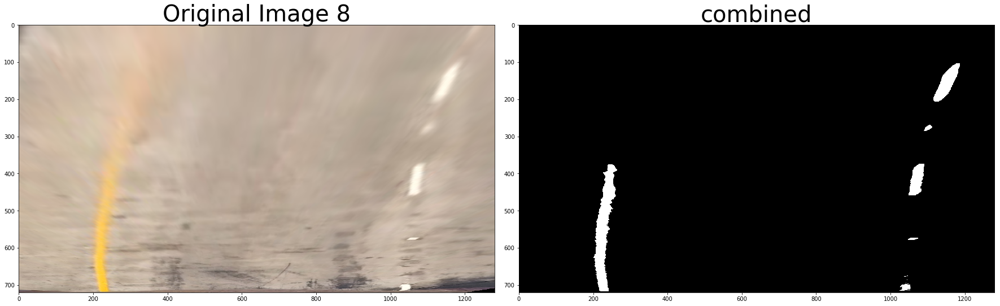

In [9]:
def handleGradient(img):
    s_channel = cv2.cvtColor(img, cv2.COLOR_BGR2HLS)[:,:,2]
    l_channel = cv2.cvtColor(img, cv2.COLOR_BGR2LUV)[:,:,0]
 
    s_thresh_min = 175
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh_min)] = 1
    
    l_thresh_min = 210
    l_binary = np.zeros_like(l_channel)
    l_binary[l_channel >= l_thresh_min] = 1

    combined_binary = np.zeros_like(s_binary)
    combined_binary[((l_binary == 1) | (s_binary == 1))] = 1
    return combined_binary

gradiatedImages = []
displayed = False    
for img in warppedImages :
    resultImg = handleGradient(img)
    
    if not displayed :
        showResultImages(i, img, resultImg, title2 = "combined", cmap2="gray")
        displayed = True
    gradiatedImages.append(resultImg)
    i = i + 1
    

    

## Apply Polynomial

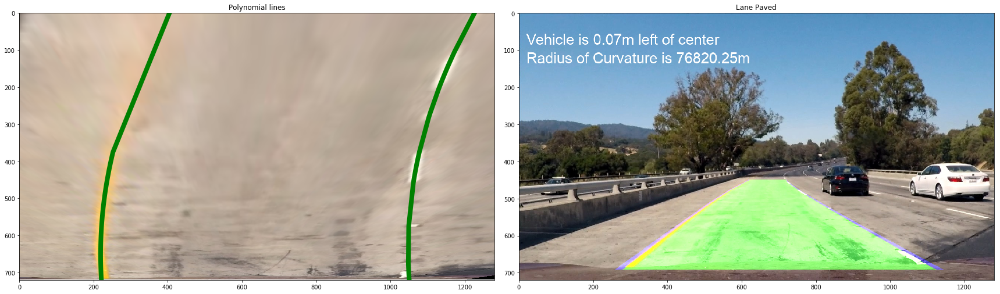

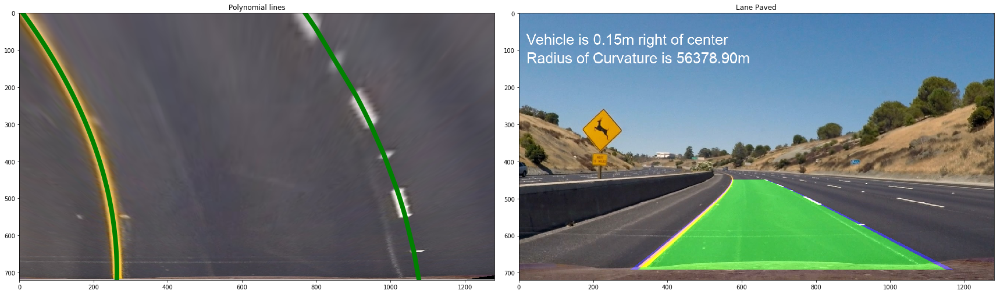

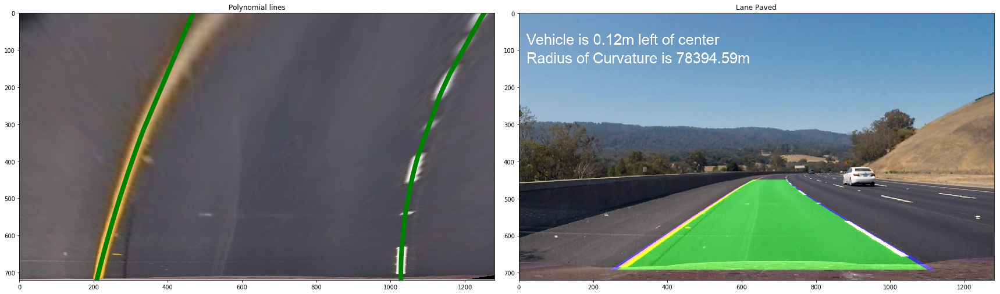

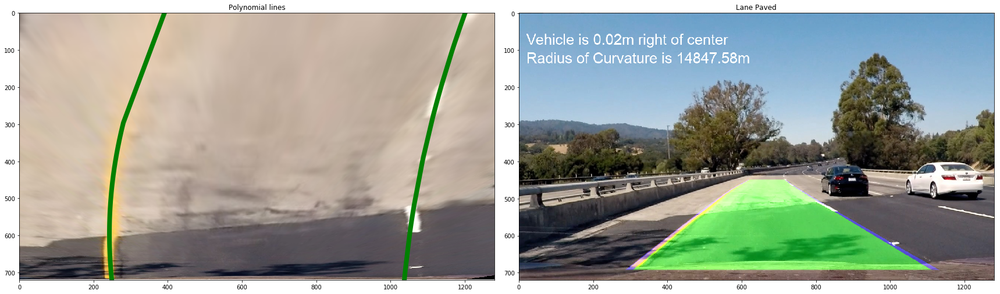

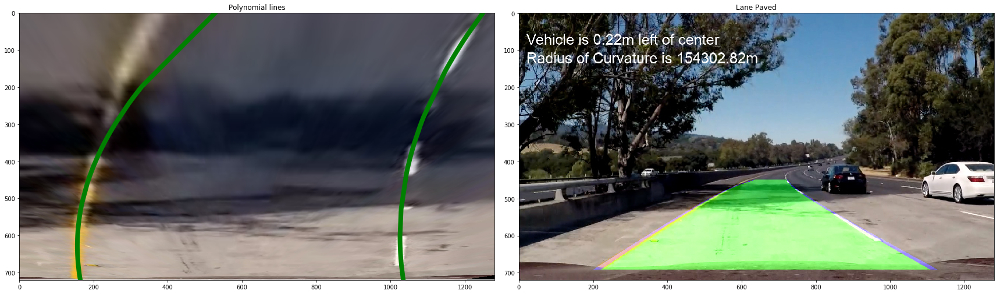

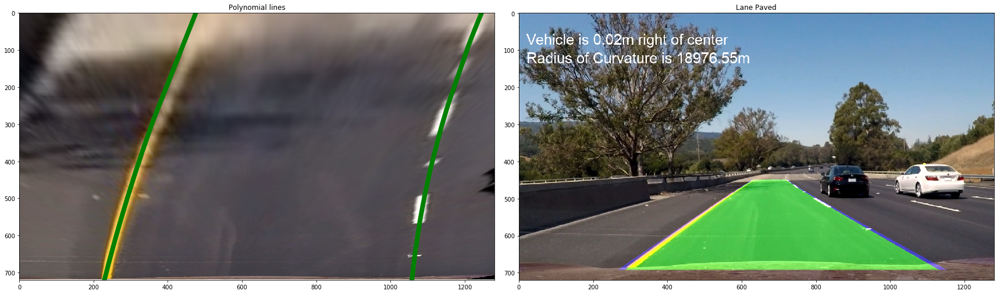

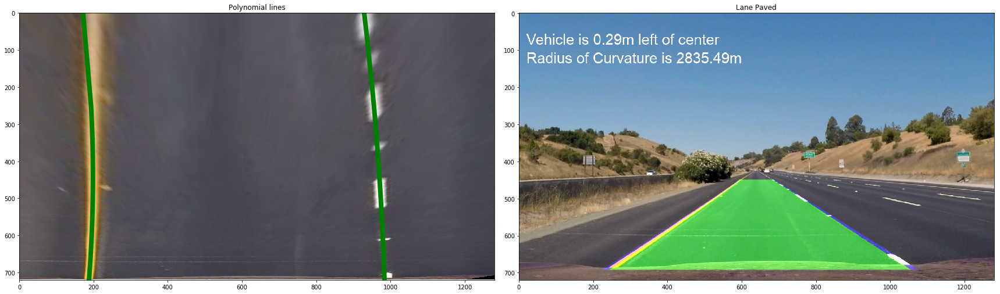

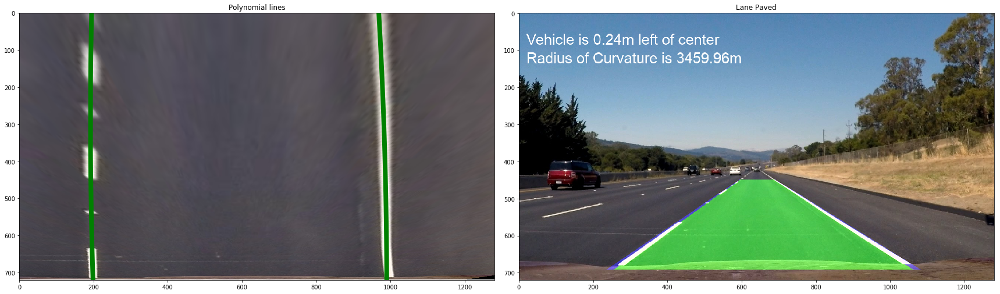

In [10]:
# Measure Radius of Curvature for each lane line
ym_per_pix = 30./720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meteres per pixel in x dimension
img_size = (h, w)
blue = (0, 0, 255)
green = (0, 255, 0)
markSize = 8

textFontSize = 40

def calcWindow(hist, arr, x, y, i, j, offset = 0) : 
    range = 25
    peak = np.argmax(hist) + offset
    idx =  np.where((((peak - range) < x)&(x < (peak + range))&((y > j) & (y < i))))
    x_window, y_window = x[idx], y[idx]
    if np.sum(x_window) != 0:
        arr[0].extend(x_window.tolist())
        arr[1].extend(y_window.tolist())

def calc(arr, xm) :
    arry = np.array(arr[1]).astype(np.float32)
    arrx = np.array(arr[0]).astype(np.float32)
    
    arr_fit = np.polyfit(arry, arrx, 2)
    arr_fitx = arr_fit[0] * arry ** 2 + arr_fit[1] * arry + arr_fit[2]
    arrx_int = arr_fit[0] * h ** 2 + arr_fit[1] * h  + arr_fit[2]
    arrx = np.append(arrx, arrx_int)
    arry = np.append(arry, h)
    arrx = np.append(arrx, arr_fit[2])
    arry = np.append(arry, 0)
    lsort = np.argsort(arry)
    arry = arry[lsort]
    arrx = arrx[lsort]
    arr_fit = np.polyfit(arry, arrx, 2)
    arr_fitx = arr_fit[0] * arry ** 2 + arr_fit[1] * arry + arr_fit[2]
    arr_fit_cr = np.polyfit(arry * ym_per_pix, arrx * xm , 2)
    
    arr_curverad = ((1 + (2*arr_fit_cr[0]*np.max(arry) + arr_fit_cr[1])**2)**1.5) \
                                 /np.absolute(2*arr_fit_cr[0])

    return arry, arrx_int, arr_fitx, arr_curverad

def displayLane(backgroundImage, result, left_fitx, right_fitx, lefty, righty) :
    f, (ax1, ax2) = plt.subplots(1,2, figsize=(24, 16))
    f.tight_layout()
    ax1.imshow(backgroundImage)
    ax1.set_xlim(0, w)
    ax1.set_ylim(0, h)
    ax1.plot(left_fitx, lefty, color='green', linewidth = markSize)
    ax1.plot(right_fitx, righty, color='green', linewidth = markSize)
    ax1.set_title('Polynomial lines')
    ax1.invert_yaxis() 
    ax2.imshow(result)
    ax2.set_title('Lane Paved')
    
def decorateResultImage(result, center, left_curverad, right_curverad) :
    direction = "left" if center > 0 else "right" 
    distance = round(abs(center)*3.7/700, 2)
    centerDistance = (left_curverad + right_curverad) / 2
    
    img = Image.fromarray(result)
    draw = ImageDraw.Draw(img)
    
    fnt = ImageFont.truetype("Arial.ttf", textFontSize)
    
    draw.text((20, 50), 'Vehicle is {0:.2f}m '.format(distance) + direction + ' of center', font = fnt)
    draw.text((20, 100), 'Radius of Curvature is {0:.2f}m'.format(centerDistance), font = fnt)
    result = np.asarray(img)
    del draw
    return result
    
def fill_lane(rawImage, resultImage, backgroundImage, showImage = False):
    left = [[], []]
    right =[[], []]
    
    x, y = np.nonzero(np.transpose(resultImage))
    midx = w // 2
    step = -10
    
    for i, j in zip(range(h, 0, step), range(midx, 0, step)):
        histogram = np.sum(resultImage[j : i, :], axis=0)     
        calcWindow(histogram[ : midx], left, x, y, i, j)
        calcWindow(histogram[midx :], right, x, y, i, j, midx)

    lefty, leftx_int, left_fitx, left_curverad = calc(left, xm_per_pix)  
    pts_left = np.array([np.flipud(np.transpose(np.vstack([left_fitx, lefty])))])
    
    righty, rightx_int, right_fitx, right_curverad = calc(right, ym_per_pix) 
    pts_right = np.array([np.transpose(np.vstack([right_fitx, righty]))])

    pts = np.hstack((pts_left, pts_right))
    
    # calculate the vehicle position, negative means left, positive means right
    center = midx - (rightx_int + leftx_int)//2
    
    warp_zero = np.zeros_like(resultImage).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    cv2.polylines(color_warp, np.int_([pts]), isClosed=False, color=blue, thickness = 40)
    cv2.fillPoly(color_warp, np.int_([pts]), green)
    newwarp = cv2.warpPerspective(color_warp, MinV, (w, h))
    result = cv2.addWeighted(rawImage, 1, newwarp, 0.5, 0)
    
    result = decorateResultImage(result, center, left_curverad, right_curverad)
    
    if showImage :
        displayLane(backgroundImage, result, left_fitx, right_fitx, lefty, righty)
    return result

for i in range(0, 8) :
    img = fill_lane(rawImages[i], gradiatedImages[i], warppedImages[i], True)


## Orchestrate method

In [11]:


def process_image(testImg) :
    mtx, dist, undistorted = cal_undistort(testImg, objpoints, imgpoints)
    warppedImg = cv2.warpPerspective(undistorted, M, (w, h))
    gradiantImg = handleGradient(warppedImg)
    resultImg = fill_lane(testImg, gradiantImg, warppedImg)
    return resultImg



## Calling from video

In [ ]:
from moviepy.editor import VideoFileClip
name = "project"
project_output = 'output_images/' + name + '_output.mp4'
clip1 = VideoFileClip(name + '_video.mp4')
project_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time project_clip.write_videofile(project_output, audio=False)

[MoviePy] >>>> Building video output_images/project_output.mp4
[MoviePy] Writing video output_images/project_output.mp4


 50%|█████     | 632/1261 [13:42<08:28,  1.24it/s]